In [1]:
import numpy as np 
import pandas as pd 

import matplotlib.pyplot as plt
from matplotlib import dates as md
import seaborn as sns
import plotly.graph_objs as go
import plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
cf.set_config_file(offline=True)

import lightgbm as lgb

from catboost import CatBoostRegressor

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error

import statsmodels.api as sm
import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/ashrae-energy-prediction/sample_submission.csv
/kaggle/input/ashrae-energy-prediction/building_metadata.csv
/kaggle/input/ashrae-energy-prediction/weather_train.csv
/kaggle/input/ashrae-energy-prediction/weather_test.csv
/kaggle/input/ashrae-energy-prediction/train.csv
/kaggle/input/ashrae-energy-prediction/test.csv


building_meta.csv
* site_id - Foreign key for the weather files.
* building_id - Foreign key for training.csv
* primary_use - Indicator of the primary category of activities for the building based on EnergyStar property type definitions
* square_feet - Gross floor area of the building
* year_built - Year building was opened
* floor_count - Number of floors of the building

In [2]:
df_meta = pd.read_csv('/kaggle/input/ashrae-energy-prediction/building_metadata.csv')
df_meta

,site_id,building_id,primary_use,square_feet,year_built,floor_count
0,0,0,Education,7432,2008.0,NaN
1,0,1,Education,2720,2004.0,NaN
2,0,2,Education,5376,1991.0,NaN
3,0,3,Education,23685,2002.0,NaN
4,0,4,Education,116607,1975.0,NaN
...,...,...,...,...,...,...
1444,15,1444,Entertainment/public assembly,19619,1914.0,NaN
1445,15,1445,Education,4298,NaN,NaN
1446,15,1446,Entertainment/public assembly,11265,1997.0,NaN
1447,15,1447,Lodging/residential,29775,2001.0,NaN


In [3]:
# Sort by site_id 0 ('Weather data from a meteorological station as close as possible to the site')
df_meta = df_meta[df_meta['site_id']== 0]
df_meta

,site_id,building_id,primary_use,square_feet,year_built,floor_count
0,0,0,Education,7432,2008.0,NaN
1,0,1,Education,2720,2004.0,NaN
2,0,2,Education,5376,1991.0,NaN
3,0,3,Education,23685,2002.0,NaN
4,0,4,Education,116607,1975.0,NaN
...,...,...,...,...,...,...
100,0,100,Lodging/residential,24456,1968.0,NaN
101,0,101,Office,18860,1986.0,NaN
102,0,102,Office,15876,1983.0,NaN
103,0,103,Education,21657,2016.0,NaN


train.csv
* building_id - Foreign key for the building metadata.
* meter - The meter id code. Read as {0: electricity, 1: chilledwater, 2: steam, 3: hotwater}. Not every building has all meter types.
* timestamp - When the measurement was taken
* meter_reading - The target variable. Energy consumption in kWh (or equivalent). Note that this is real data with measurement error, which we expect will impose a baseline level of modeling error. UPDATE: as discussed here, the site 0 electric meter readings are in kBTU.

In [4]:
df_train = pd.read_csv('/kaggle/input/ashrae-energy-prediction/train.csv', index_col = 'timestamp', parse_dates=True)
df_train_electricity = df_train.loc[df_train.meter == 0] # return only for electricity (meter nr 0)
df_train_electricity

,building_id,meter,meter_reading
timestamp,,,
2016-01-01 00:00:00,0,0,0.000
2016-01-01 00:00:00,1,0,0.000
2016-01-01 00:00:00,2,0,0.000
2016-01-01 00:00:00,3,0,0.000
2016-01-01 00:00:00,4,0,0.000
...,...,...,...
2016-12-31 23:00:00,1444,0,8.750
2016-12-31 23:00:00,1445,0,4.825
2016-12-31 23:00:00,1446,0,0.000


weather_train.csv
Weather data from a meteorological station as close as possible to the site.

* site_id
* air_temperature - Degrees Celsius
* cloud_coverage - Portion of the sky covered in clouds, in oktas
* dew_temperature - Degrees Celsius
* precip_depth_1_hr - Millimeters
* sea_level_pressure - Millibar/hectopascals
* wind_direction - Compass direction (0-360)
* wind_speed - Meters per second

In [5]:
df_weather = pd.read_csv('/kaggle/input/ashrae-energy-prediction/weather_train.csv', index_col = 'timestamp', parse_dates = True)
df_weather

,site_id,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,sea_level_pressure,wind_direction,wind_speed
timestamp,,,,,,,,
2016-01-01 00:00:00,0,25.0,6.0,20.0,NaN,1019.7,0.0,0.0
2016-01-01 01:00:00,0,24.4,NaN,21.1,-1.0,1020.2,70.0,1.5
2016-01-01 02:00:00,0,22.8,2.0,21.1,0.0,1020.2,0.0,0.0
2016-01-01 03:00:00,0,21.1,2.0,20.6,0.0,1020.1,0.0,0.0
2016-01-01 04:00:00,0,20.0,2.0,20.0,-1.0,1020.0,250.0,2.6
...,...,...,...,...,...,...,...,...
2016-12-31 19:00:00,15,3.0,NaN,-8.0,NaN,NaN,180.0,5.7
2016-12-31 20:00:00,15,2.8,2.0,-8.9,NaN,1007.4,180.0,7.7
2016-12-31 21:00:00,15,2.8,NaN,-7.2,NaN,1007.5,180.0,5.1


In [6]:
for col in df_weather.columns:
    df_weather[col] = df_weather[col].interpolate(limit_direction = 'both') # fill "na" values

df_weather

,site_id,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,sea_level_pressure,wind_direction,wind_speed
timestamp,,,,,,,,
2016-01-01 00:00:00,0,25.0,6.0,20.0,-1.0,1019.70,0.0,0.0
2016-01-01 01:00:00,0,24.4,4.0,21.1,-1.0,1020.20,70.0,1.5
2016-01-01 02:00:00,0,22.8,2.0,21.1,0.0,1020.20,0.0,0.0
2016-01-01 03:00:00,0,21.1,2.0,20.6,0.0,1020.10,0.0,0.0
2016-01-01 04:00:00,0,20.0,2.0,20.0,-1.0,1020.00,250.0,2.6
...,...,...,...,...,...,...,...,...
2016-12-31 19:00:00,15,3.0,1.5,-8.0,-1.0,1007.55,180.0,5.7
2016-12-31 20:00:00,15,2.8,2.0,-8.9,-1.0,1007.40,180.0,7.7
2016-12-31 21:00:00,15,2.8,2.0,-7.2,-1.0,1007.50,180.0,5.1


In [7]:
# Create moving average 
df_weather['temperatureC_movingAvg_3hr'] = df_weather['air_temperature'].rolling(3).mean()
df_weather['temperatureC_movingAvg_6hr'] = df_weather['air_temperature'].rolling(6).mean()
df_weather['temperatureC_movingAvg_12hr'] = df_weather['air_temperature'].rolling(12).mean()
df_weather['temperatureC_movingAvg_24hr'] = df_weather['air_temperature'].rolling(24).mean()
#df_weather.loc[:, df_weather.columns.str.contains('temperature')].iplot()
df_weather

,site_id,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,sea_level_pressure,wind_direction,wind_speed,temperatureC_movingAvg_3hr,temperatureC_movingAvg_6hr,temperatureC_movingAvg_12hr,temperatureC_movingAvg_24hr
timestamp,,,,,,,,,,,,
2016-01-01 00:00:00,0,25.0,6.0,20.0,-1.0,1019.70,0.0,0.0,NaN,NaN,NaN,NaN
2016-01-01 01:00:00,0,24.4,4.0,21.1,-1.0,1020.20,70.0,1.5,NaN,NaN,NaN,NaN
2016-01-01 02:00:00,0,22.8,2.0,21.1,0.0,1020.20,0.0,0.0,24.066667,NaN,NaN,NaN
2016-01-01 03:00:00,0,21.1,2.0,20.6,0.0,1020.10,0.0,0.0,22.766667,NaN,NaN,NaN
2016-01-01 04:00:00,0,20.0,2.0,20.0,-1.0,1020.00,250.0,2.6,21.300000,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 19:00:00,15,3.0,1.5,-8.0,-1.0,1007.55,180.0,5.7,2.666667,0.483333,-1.508333,-2.391667
2016-12-31 20:00:00,15,2.8,2.0,-8.9,-1.0,1007.40,180.0,7.7,2.866667,1.416667,-0.950000,-2.183333
2016-12-31 21:00:00,15,2.8,2.0,-7.2,-1.0,1007.50,180.0,5.1,2.866667,2.166667,-0.391667,-1.995833


In [8]:
df_holiday = pd.read_html('https://www.timeanddate.com/holidays/us/2016')[0] # read data from web
df_holiday.columns = df_holiday.columns.get_level_values(0) 
df_holiday = df_holiday.loc[df_holiday['Date'].str.len()<100] # Keep length of valuest in column date less than 100 symbols
df_holiday = df_holiday[['Date', 'Name', 'Type']] # Keep only columns 'Date', 'Name', 'Type'
df_holiday['Date'] = '2016 ' + df_holiday['Date'] # Add '2016' in front of each value in column 'Date'
df_holiday['Date'] = df_holiday['Date'].str.replace('mrt', 'mar') # fixed incorrect abbreviation of the months
df_holiday['Date'] = df_holiday['Date'].str.replace('mei', 'may') # fixed incorrect abbreviation of the months
df_holiday['Date'] = df_holiday['Date'].str.replace('okt', 'oct') # fixed incorrect abbreviation of the months
df_holiday['Date'] = pd.to_datetime(df_holiday['Date']) # change format to datetime format
df_holiday = df_holiday.rename(columns={'Date':'date'}) # rename column 'Date' to 'date'
df_holiday = df_holiday.drop_duplicates(subset=['date']) # drop duplicates in column 'date'
df_holiday = df_holiday.set_index('date').asfreq('D') # convert df_holiday to "day" frequency
df_holiday.loc[df_holiday.index.weekday>=5, 'Name'] = 'weekend' # rename values corresponds Saturday and Sunday to weekend for column 'Name'
df_holiday.loc[df_holiday.index.weekday>=5, 'Type'] = 'weekend' # rename values corresponds Saturday and Sunday to weekend for column 'Type'
df_holiday.columns = 'holiday_' + df_holiday.columns # add 'holiday' in front of each name of the column

df_holiday

,holiday_Name,holiday_Type
date,,
2016-01-01,New Year's Day,Federal Holiday
2016-01-02,weekend,weekend
2016-01-03,weekend,weekend
2016-01-04,World Braille Day,Worldwide observance
2016-01-05,NaN,NaN
...,...,...
2016-12-27,Washington's Birthday,State holiday
2016-12-28,NaN,NaN
2016-12-29,NaN,NaN


In [9]:
# OneHotencoder
categorical_data = df_holiday.copy()
df_holiday_encode = pd.get_dummies(categorical_data)

df_holiday_encode

,holiday_Name_Administrative Professionals Day,holiday_Name_African Liberation Day,holiday_Name_Alaska Day,holiday_Name_All Saints' Day,holiday_Name_All Souls' Day,holiday_Name_April Fool's Day,holiday_Name_Ascension Day,holiday_Name_Ash Wednesday,holiday_Name_Assumption of Mary,holiday_Name_Bastille Day,...,holiday_Type_Observance,"holiday_Type_Observance, Christian",holiday_Type_Orthodox,holiday_Type_Season,holiday_Type_Sporting event,holiday_Type_State Observation,holiday_Type_State holiday,holiday_Type_United Nations observance,holiday_Type_Worldwide observance,holiday_Type_weekend
date,,,,,,,,,,,,,,,,,,,,,
2016-01-01,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-01-02,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2016-01-03,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2016-01-04,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2016-01-05,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
2016-12-28,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2016-12-29,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [10]:
# LabelEncoder
df_holiday_encode_l = df_holiday.copy()
df_holiday_encode_l[['holiday_Name', 'holiday_Type']] = df_holiday_encode_l[['holiday_Name', 'holiday_Type']].astype('str').apply(LabelEncoder().fit_transform) 

df_holiday_encode_l

,holiday_Name,holiday_Type
date,,
2016-01-01,106,1
2016-01-02,175,17
2016-01-03,175,17
2016-01-04,141,15
2016-01-05,174,16
...,...,...
2016-12-27,136,13
2016-12-28,174,16
2016-12-29,174,16


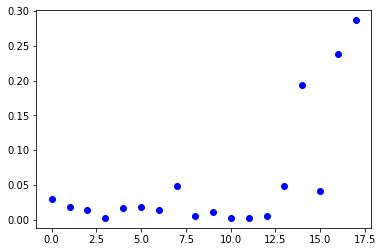

In [11]:
plt.plot(df_holiday_encode_l['holiday_Type'].value_counts(normalize= True), 'ob')
plt.show()

In [12]:
piv_tab_2 = df_train_electricity.pivot_table(index = 'timestamp', columns = 'building_id', values = 'meter_reading') # site_id - Foreign key for the weather files
piv_tab_2.reset_index()
piv_tab_2

building_id,0,1,2,3,4,5,6,7,8,9,...,1439,1440,1441,1442,1443,1444,1445,1446,1447,1448
timestamp,,,,,,,,,,,,,,,,,,,,,
2016-01-01 00:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,201.600,160.950,248.525,54.625,57.725,5.425,4.800,0.0,160.200,2.325
2016-01-01 01:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,204.650,165.250,259.375,63.225,63.350,5.550,4.825,0.0,156.650,2.225
2016-01-01 02:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,202.775,161.675,250.475,53.675,62.875,5.900,5.125,0.0,157.575,2.275
2016-01-01 03:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,199.800,164.850,259.625,58.075,64.250,5.525,5.225,0.0,154.925,2.575
2016-01-01 04:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,197.700,158.750,247.400,58.500,64.675,5.725,5.250,0.0,156.075,3.075
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 19:00:00,232.071,68.2560,4.9144,107.162,1150.80,10.2384,264.970,550.826,555.604,61.4304,...,176.525,165.825,245.675,61.500,83.725,8.525,5.750,0.0,167.800,3.400
2016-12-31 20:00:00,189.069,52.4206,5.3240,107.162,1197.89,18.7704,265.379,593.145,577.446,61.4304,...,171.225,163.875,250.125,55.475,85.175,8.950,5.850,0.0,168.150,2.700
2016-12-31 21:00:00,169.958,53.5127,5.7335,106.821,1147.38,9.2146,263.741,557.993,540.246,63.0686,...,169.725,162.400,247.875,61.925,83.825,8.700,5.725,0.0,164.075,3.050


In [13]:
df_site = pd.DataFrame(piv_tab_2.to_records())
df_site = df_site.set_index('timestamp')
df_site

,0,1,2,3,4,5,6,7,8,9,...,1439,1440,1441,1442,1443,1444,1445,1446,1447,1448
timestamp,,,,,,,,,,,,,,,,,,,,,
2016-01-01 00:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,201.600,160.950,248.525,54.625,57.725,5.425,4.800,0.0,160.200,2.325
2016-01-01 01:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,204.650,165.250,259.375,63.225,63.350,5.550,4.825,0.0,156.650,2.225
2016-01-01 02:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,202.775,161.675,250.475,53.675,62.875,5.900,5.125,0.0,157.575,2.275
2016-01-01 03:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,199.800,164.850,259.625,58.075,64.250,5.525,5.225,0.0,154.925,2.575
2016-01-01 04:00:00,0.000,0.0000,0.0000,0.000,0.00,0.0000,0.000,0.000,0.000,0.0000,...,197.700,158.750,247.400,58.500,64.675,5.725,5.250,0.0,156.075,3.075
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 19:00:00,232.071,68.2560,4.9144,107.162,1150.80,10.2384,264.970,550.826,555.604,61.4304,...,176.525,165.825,245.675,61.500,83.725,8.525,5.750,0.0,167.800,3.400
2016-12-31 20:00:00,189.069,52.4206,5.3240,107.162,1197.89,18.7704,265.379,593.145,577.446,61.4304,...,171.225,163.875,250.125,55.475,85.175,8.950,5.850,0.0,168.150,2.700
2016-12-31 21:00:00,169.958,53.5127,5.7335,106.821,1147.38,9.2146,263.741,557.993,540.246,63.0686,...,169.725,162.400,247.875,61.925,83.825,8.700,5.725,0.0,164.075,3.050


Model 1: Only timestamp features

In [14]:
name_meter = '1439' # Choose one of the meters 

In [15]:
# Prepare data for modeling
df_temp = df_site[[name_meter]].copy() # Create new dataframe from df_powerMeter_site2 with name_meter column
df_temp = df_temp.dropna() # drop na from df_temp

# Add timestamp features
df_temp['weekday'] = df_temp.index.weekday # add new column 'weekday' in df_temp. Extract week day from timestamp
df_temp['hour'] = df_temp.index.hour # add new column 'hour' in df_temp. Extract hour from timestamp
df_temp['date'] = df_temp.index.date # add new column 'date' in df_temp. Extract date from timestamp

df_temp = df_temp.rename(columns={name_meter: 'load_meas'}) # rename 'name_meter' column to 'load_meas'

df_temp

,load_meas,weekday,hour,date
timestamp,,,,
2016-01-01 00:00:00,201.600,4,0,2016-01-01
2016-01-01 01:00:00,204.650,4,1,2016-01-01
2016-01-01 02:00:00,202.775,4,2,2016-01-01
2016-01-01 03:00:00,199.800,4,3,2016-01-01
2016-01-01 04:00:00,197.700,4,4,2016-01-01
...,...,...,...,...
2016-12-31 19:00:00,176.525,5,19,2016-12-31
2016-12-31 20:00:00,171.225,5,20,2016-12-31
2016-12-31 21:00:00,169.725,5,21,2016-12-31


In [16]:
# Weekly profiles of building energy
df_plot = df_temp.copy() # create a new dataframe from df_temp dataframe
df_plot['date'] = pd.to_datetime(df_plot.index.date) # define 'date' as datetime format
temp = df_plot.pivot_table(columns=['weekday','hour'], index='date', values='load_meas').T # create pivot_table and make it transpose. Load_meas by hours
temp

date          2016-01-01  2016-01-02  2016-01-03  2016-01-04  2016-01-05  \
weekday hour                                                               
0       0            NaN         NaN         NaN     208.375         NaN   
        1            NaN         NaN         NaN     203.225         NaN   
        2            NaN         NaN         NaN     208.875         NaN   
        3            NaN         NaN         NaN     209.300         NaN   
        4            NaN         NaN         NaN     204.600         NaN   
...                  ...         ...         ...         ...         ...   
6       19           NaN         NaN     212.825         NaN         NaN   
        20           NaN         NaN     205.500         NaN         NaN   
        21           NaN         NaN     210.325         NaN         NaN   
        22           NaN         NaN     210.800         NaN         NaN   
        23           NaN         NaN     206.975         NaN         NaN   

date          2016-01-06  2016-01-07  2016-01-08  2016-01-09  2016-01-10  ...  \
weekday hour                                                              ...   
0       0            NaN         NaN         NaN         NaN         NaN  ...   
        1            NaN         NaN         NaN         NaN         NaN  ...   
        2            NaN         NaN         NaN         NaN         NaN  ...   
        3            NaN         NaN         NaN         NaN         NaN  ...   
        4            NaN         NaN         NaN         NaN         NaN  ...   
...                  ...         ...         ...         ...         ...  ...   
6       19           NaN         NaN         NaN         NaN     216.450  ...   
        20           NaN         NaN         NaN         NaN     214.575  ...   
        21           NaN         NaN         NaN         NaN     214.925  ...   
        22           NaN         NaN         NaN         NaN     219.850  ...   
        23           NaN         NaN         NaN         NaN     213.950  ...   

date          2016-12-22  2016-12-23  2016-12-24  2016-12-25  2016-12-26  \
weekday hour                                                               
0       0            NaN         NaN         NaN         NaN     167.025   
        1            NaN         NaN         NaN         NaN     170.175   
        2            NaN         NaN         NaN         NaN     165.975   
        3            NaN         NaN         NaN         NaN     167.975   
        4            NaN         NaN         NaN         NaN     171.625   
...                  ...         ...         ...         ...         ...   
6       19           NaN         NaN         NaN     181.725         NaN   
        20           NaN         NaN         NaN     176.750         NaN   
        21           NaN         NaN         NaN     171.825         NaN   
        22           NaN         NaN         NaN     176.025         NaN   
        23           NaN         NaN         NaN     169.000         NaN   

date          2016-12-27  2016-12-28  2016-12-29  2016-12-30  2016-12-31  
weekday hour                                                              
0       0            NaN         NaN         NaN         NaN         NaN  
        1            NaN         NaN         NaN         NaN         NaN  
        2            NaN         NaN         NaN         NaN         NaN  
        3            NaN         NaN         NaN         NaN         NaN  
        4            NaN         NaN         NaN         NaN         NaN  
...                  ...         ...         ...         ...         ...  
6       19           NaN         NaN         NaN         NaN         NaN  
        20           NaN         NaN         NaN         NaN         NaN  
        21           NaN         NaN         NaN         NaN         NaN  
        22           NaN         NaN         NaN         NaN         NaN  
        23           NaN         NaN         NaN         NaN        

<AxesSubplot:xlabel='weekday,hour'>

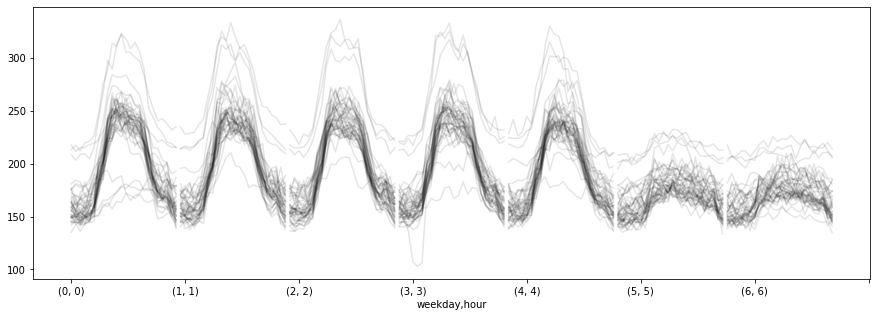

In [17]:
temp.plot(figsize=(15,5),color='black',alpha=0.1,legend=False) # Visualisation

In [18]:
traindata = df_temp.loc[df_temp.index.month.isin([1,2,3,5,6,7,9,10,11])].copy() # train data include 1,2,3,5,6,7,9,10,11 months
testdata = df_temp.loc[df_temp.index.month.isin([4,8,12])].copy() # test data include 4,8,12 months

train_labels = traindata['load_meas'] # define train_labels
test_labels = testdata['load_meas'] # define test_labels

train_features = traindata.drop(['load_meas', 'date'], axis=1) # define train_features
test_features = testdata.drop(['load_meas', 'date'], axis=1) # define test_features

LGB_model = lgb.LGBMRegressor()
LGB_model.fit(train_features, train_labels)

testdata['load_pred'] = LGB_model.predict(test_features) # add new column 'load_pred' in testdata and fill it with predictions 


errors = abs(testdata['load_pred'] - test_labels) # Calculate the absolute errors

RSQUARED = r2_score(testdata.dropna()['load_meas'], testdata.dropna()['load_pred']) # R2 calculation

print("R SQUARED: "+ str(round(RSQUARED,4))) # print R2 rounded to four characters
testdata[['load_meas', 'load_pred']].iplot() # visualisation 

R SQUARED: 0.8325


Model 2: Timestamp features + Weather + Holidays (OneHotEncode)

In [19]:
holiday_Type = df_holiday_encode.loc[:, df_holiday_encode.columns.str.contains('holiday_Type')].reset_index()

holiday_Type.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 366 entries, 0 to 365
Data columns (total 18 columns):
 #   Column                                  Non-Null Count  Dtype         
---  ------                                  --------------  -----         
 0   date                                    366 non-null    datetime64[ns]
 1   holiday_Type_Christian                  366 non-null    uint8         
 2   holiday_Type_Federal Holiday            366 non-null    uint8         
 3   holiday_Type_Hindu Holiday              366 non-null    uint8         
 4   holiday_Type_Jewish commemoration       366 non-null    uint8         
 5   holiday_Type_Jewish holiday             366 non-null    uint8         
 6   holiday_Type_Local observance           366 non-null    uint8         
 7   holiday_Type_Muslim                     366 non-null    uint8         
 8   holiday_Type_Observance                 366 non-null    uint8         
 9   holiday_Type_Observance, Christian      366 non-null  

In [20]:
# Prepare data for modeling
df_temp = df_site[[name_meter]].copy() # Create new dataframe from df_powerMeter_site2 with name_meter column
df_temp = df_temp.dropna() # drop na from df_temp

# Add timestamp features
df_temp['weekday'] = df_temp.index.weekday # add new column 'weekday' in df_temp. Extract week day from timestamp
df_temp['hour'] = df_temp.index.hour # add new column 'hour' in df_temp. Extract hour from timestamp
df_temp['date'] = df_temp.index.date # add new column 'date' in df_temp. Extract date from timestamp

# Add weather features
df_temp = df_temp.rename(columns={name_meter: 'load_meas'}) # rename 'name_meter' column to 'load_meas'
df_temp = df_temp.merge(df_weather.loc[:, df_weather.columns.str.contains('temperature')], left_index = True, right_index = True) # Merge df_temp and
# df_weather dataframe (which contains in the name of the columns 'temperature')
df_temp['date'] = pd.to_datetime(df_temp.index.date)

df_temp.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 118982 entries, 2016-01-01 00:00:00 to 2016-12-31 23:00:00
Data columns (total 10 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   load_meas                    118982 non-null  float64       
 1   weekday                      118982 non-null  int64         
 2   hour                         118982 non-null  int64         
 3   date                         118982 non-null  datetime64[ns]
 4   air_temperature              118982 non-null  float64       
 5   dew_temperature              118982 non-null  float64       
 6   temperatureC_movingAvg_3hr   118980 non-null  float64       
 7   temperatureC_movingAvg_6hr   118977 non-null  float64       
 8   temperatureC_movingAvg_12hr  118971 non-null  float64       
 9   temperatureC_movingAvg_24hr  118959 non-null  float64       
dtypes: datetime64[ns](1), float64(7), int64(2)
memory usage: 1

In [21]:
# Add holiday feature
idx_df = df_temp.index.copy() # copy index from df_temp
#df_temp = df_temp.reset_index(drop = True)
df_temp = df_temp.merge(holiday_Type.reset_index(drop = True), on= 'date') # merge 
# df_temp and column'holiday_Type' from df_holiday_encode
df_temp.index = idx_df # setup index idx_df

df_temp.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 118982 entries, 2016-01-01 00:00:00 to 2016-12-31 23:00:00
Data columns (total 27 columns):
 #   Column                                  Non-Null Count   Dtype         
---  ------                                  --------------   -----         
 0   load_meas                               118982 non-null  float64       
 1   weekday                                 118982 non-null  int64         
 2   hour                                    118982 non-null  int64         
 3   date                                    118982 non-null  datetime64[ns]
 4   air_temperature                         118982 non-null  float64       
 5   dew_temperature                         118982 non-null  float64       
 6   temperatureC_movingAvg_3hr              118980 non-null  float64       
 7   temperatureC_movingAvg_6hr              118977 non-null  float64       
 8   temperatureC_movingAvg_12hr             118971 non-null  float64       
 9   tem

In [22]:
traindata = df_temp.loc[df_temp.index.month.isin([1,2,3,5,6,7,9,10,11])].copy() # train data include 1,2,3,5,6,7,9,10,11 months
testdata = df_temp.loc[df_temp.index.month.isin([4,8,12])].copy() # test data include 4,8,12 months

train_labels = traindata['load_meas'] # define train_labels
test_labels = testdata['load_meas'] # define test_labels

train_features = traindata.drop(['load_meas', 'date'], axis=1) # define train_features
test_features = testdata.drop(['load_meas', 'date'], axis=1) # define test_features

In [23]:
traindata = df_temp.loc[df_temp.index.month.isin([1,2,3,5,6,7,9,10,11])].copy() # train data include 1,2,3,5,6,7,9,10,11 months
testdata = df_temp.loc[df_temp.index.month.isin([4,8,12])].copy() # test data include 4,8,12 months

train_labels = traindata['load_meas'] # define train_labels
test_labels = testdata['load_meas'] # define test_labels

train_features = traindata.drop(['load_meas', 'date'], axis=1) # define train_features
test_features = testdata.drop(['load_meas', 'date'], axis=1) # define test_features
train_features = train_features.fillna(0)


import re
train_features = train_features.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
test_features = test_features.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

LGB_model = lgb.LGBMRegressor()
LGB_model.fit(train_features, train_labels)

testdata['load_pred'] = LGB_model.predict(test_features) # add new column 'load_pred' in testdata and fill it with predictions 


errors = abs(testdata['load_pred'] - test_labels) # Calculate the absolute errors

RSQUARED = r2_score(testdata.dropna()['load_meas'], testdata.dropna()['load_pred']) # R2 calculation

print("R SQUARED: "+ str(round(RSQUARED,4))) # print R2 rounded to four characters
testdata[['load_meas', 'load_pred']].iplot() # visualisation 

R SQUARED: 0.6284


Model 2: Timestamp features + Weather + Holidays (LabelEncode)

In [24]:
# Prepare data for modeling
df_temp = df_site[[name_meter]].copy() # Create new dataframe from df_powerMeter_site2 with name_meter column
df_temp = df_temp.dropna() # drop na from df_temp

# Add timestamp features
df_temp['weekday'] = df_temp.index.weekday # add new column 'weekday' in df_temp. Extract week day from timestamp
df_temp['hour'] = df_temp.index.hour # add new column 'hour' in df_temp. Extract hour from timestamp
df_temp['date'] = df_temp.index.date # add new column 'date' in df_temp. Extract date from timestamp

# Add weather features
df_temp = df_temp.rename(columns={name_meter: 'load_meas'}) # rename 'name_meter' column to 'load_meas'
df_temp = df_temp.merge(df_weather.loc[:, df_weather.columns.str.contains('temperature')], left_index = True, right_index = True) # Merge df_temp and
# df_weather dataframe (which contains in the name of the columns 'temperature')
df_temp['date'] = pd.to_datetime(df_temp.index.date)

# Add holiday features (LabelEncode)
idx_df = df_temp.index.copy() # copy index from df_temp
df_temp = df_temp.merge(df_holiday_encode_l[['holiday_Type']].reset_index(), on= 'date')# merge df_temp and column'holiday_Type' from df_holiday_encode
df_temp.index = idx_df # setup index idx_df

df_temp

,load_meas,weekday,hour,date,air_temperature,dew_temperature,temperatureC_movingAvg_3hr,temperatureC_movingAvg_6hr,temperatureC_movingAvg_12hr,temperatureC_movingAvg_24hr,holiday_Type
timestamp,,,,,,,,,,,
2016-01-01 00:00:00,201.6,4,0,2016-01-01,25.0,20.0,NaN,NaN,NaN,NaN,1
2016-01-01 00:00:00,201.6,4,0,2016-01-01,3.8,2.4,15.733333,19.433333,17.450000,12.195833,1
2016-01-01 00:00:00,201.6,4,0,2016-01-01,15.6,-5.6,10.000000,8.700000,8.650000,6.670833,1
2016-01-01 00:00:00,201.6,4,0,2016-01-01,10.0,2.2,14.466667,15.200000,14.025000,14.370833,1
2016-01-01 00:00:00,201.6,4,0,2016-01-01,-1.8,-3.2,4.400000,6.650000,4.900000,2.083333,1
...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-9.6,-10.8,-9.766667,-10.033333,-11.125000,-11.862500,17
2016-12-31 23:00:00,167.4,5,23,2016-12-31,6.5,5.3,7.766667,8.750000,9.200000,9.345833,17
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-5.6,-11.1,-5.000000,-4.350000,-4.583333,-2.766667,17


In [25]:
traindata = df_temp.loc[df_temp.index.month.isin([1,2,3,5,6,7,9,10,11])].copy() # train data include 1,2,3,5,6,7,9,10,11 months
testdata = df_temp.loc[df_temp.index.month.isin([4,8,12])].copy() # test data include 4,8,12 months

train_labels = traindata['load_meas'] # define train_labels
test_labels = testdata['load_meas'] # define test_labels

train_features = traindata.drop(['load_meas', 'date'], axis=1) # define train_features
test_features = testdata.drop(['load_meas', 'date'], axis=1) # define test_features
train_features = train_features.fillna(0)


LGB_model = lgb.LGBMRegressor()
LGB_model.fit(train_features, train_labels)

testdata['load_pred'] = LGB_model.predict(test_features) # add new column 'load_pred' in testdata and fill it with predictions 


errors = abs(testdata['load_pred'] - test_labels) # Calculate the absolute errors

RSQUARED = r2_score(testdata.dropna()['load_meas'], testdata.dropna()['load_pred']) # R2 calculation

print("R SQUARED: "+ str(round(RSQUARED,4))) # print R2 rounded to four characters
testdata[['load_meas', 'load_pred']].iplot() # visualisation 

R SQUARED: 0.6146


Model 3: Timestamp features + Weather

In [26]:
# Prepare data for modeling
df_temp = df_site[[name_meter]].copy() # Create new dataframe from df_powerMeter_site2 with name_meter column
df_temp = df_temp.dropna() # drop na from df_temp

# Add timestamp features
df_temp['weekday'] = df_temp.index.weekday # add new column 'weekday' in df_temp. Extract week day from timestamp
df_temp['hour'] = df_temp.index.hour # add new column 'hour' in df_temp. Extract hour from timestamp
df_temp['date'] = df_temp.index.date # add new column 'date' in df_temp. Extract date from timestamp

# Add weather features
df_temp = df_temp.rename(columns={name_meter: 'load_meas'}) # rename 'name_meter' column to 'load_meas'
df_temp = df_temp.merge(df_weather.loc[:, df_weather.columns.str.contains('temperature')], left_index = True, right_index = True) # Merge df_temp and
# df_weather dataframe (which contains in the name of the columns 'temperature')
df_temp['date'] = pd.to_datetime(df_temp.index.date)

df_temp

,load_meas,weekday,hour,date,air_temperature,dew_temperature,temperatureC_movingAvg_3hr,temperatureC_movingAvg_6hr,temperatureC_movingAvg_12hr,temperatureC_movingAvg_24hr
timestamp,,,,,,,,,,
2016-01-01 00:00:00,201.6,4,0,2016-01-01,25.0,20.0,NaN,NaN,NaN,NaN
2016-01-01 00:00:00,201.6,4,0,2016-01-01,3.8,2.4,15.733333,19.433333,17.450000,12.195833
2016-01-01 00:00:00,201.6,4,0,2016-01-01,15.6,-5.6,10.000000,8.700000,8.650000,6.670833
2016-01-01 00:00:00,201.6,4,0,2016-01-01,10.0,2.2,14.466667,15.200000,14.025000,14.370833
2016-01-01 00:00:00,201.6,4,0,2016-01-01,-1.8,-3.2,4.400000,6.650000,4.900000,2.083333
...,...,...,...,...,...,...,...,...,...,...
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-9.6,-10.8,-9.766667,-10.033333,-11.125000,-11.862500
2016-12-31 23:00:00,167.4,5,23,2016-12-31,6.5,5.3,7.766667,8.750000,9.200000,9.345833
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-5.6,-11.1,-5.000000,-4.350000,-4.583333,-2.766667


In [27]:
traindata = df_temp.loc[df_temp.index.month.isin([1,2,3,5,6,7,9,10,11])].copy() # train data include 1,2,3,5,6,7,9,10,11 months
testdata = df_temp.loc[df_temp.index.month.isin([4,8,12])].copy() # test data include 4,8,12 months

train_labels = traindata['load_meas'] # define train_labels
test_labels = testdata['load_meas'] # define test_labels

train_features = traindata.drop(['load_meas', 'date'], axis=1) # define train_features
test_features = testdata.drop(['load_meas', 'date'], axis=1) # define test_features
train_features = train_features.fillna(0)


LGB_model = lgb.LGBMRegressor()
LGB_model.fit(train_features, train_labels)

testdata['load_pred'] = LGB_model.predict(test_features) # add new column 'load_pred' in testdata and fill it with predictions 


errors = abs(testdata['load_pred'] - test_labels) # Calculate the absolute errors

RSQUARED = r2_score(testdata.dropna()['load_meas'], testdata.dropna()['load_pred']) # R2 calculation

print("R SQUARED: "+ str(round(RSQUARED,4))) # print R2 rounded to four characters
testdata[['load_meas', 'load_pred']].iplot() # visualisation 

R SQUARED: 0.7073


Model 4: Timestamp features + Weather + Lag feature

In [28]:
# Prepare data for modeling
df_temp = df_site[[name_meter]].copy() # Create new dataframe from df_powerMeter_site2 with name_meter column
df_temp = df_temp.dropna() # drop na from df_temp

# Add timestamp features
df_temp['weekday'] = df_temp.index.weekday # add new column 'weekday' in df_temp. Extract week day from timestamp
df_temp['hour'] = df_temp.index.hour # add new column 'hour' in df_temp. Extract hour from timestamp
df_temp['date'] = df_temp.index.date # add new column 'date' in df_temp. Extract date from timestamp

# Add weather features
df_temp = df_temp.rename(columns={name_meter: 'load_meas'}) # rename 'name_meter' column to 'load_meas'
df_temp = df_temp.merge(df_weather.loc[:, df_weather.columns.str.contains('temperature')], left_index = True, right_index = True) # Merge df_temp and
# df_weather dataframe (which contains in the name of the columns 'temperature')
df_temp['date'] = pd.to_datetime(df_temp.index.date)

# Add lag features
df_temp['load_shift_24hrs'] = df_temp['load_meas'].shift(24) # Shift 'load_meas' 1 day

df_temp

,load_meas,weekday,hour,date,air_temperature,dew_temperature,temperatureC_movingAvg_3hr,temperatureC_movingAvg_6hr,temperatureC_movingAvg_12hr,temperatureC_movingAvg_24hr,load_shift_24hrs
timestamp,,,,,,,,,,,
2016-01-01 00:00:00,201.6,4,0,2016-01-01,25.0,20.0,NaN,NaN,NaN,NaN,NaN
2016-01-01 00:00:00,201.6,4,0,2016-01-01,3.8,2.4,15.733333,19.433333,17.450000,12.195833,NaN
2016-01-01 00:00:00,201.6,4,0,2016-01-01,15.6,-5.6,10.000000,8.700000,8.650000,6.670833,NaN
2016-01-01 00:00:00,201.6,4,0,2016-01-01,10.0,2.2,14.466667,15.200000,14.025000,14.370833,NaN
2016-01-01 00:00:00,201.6,4,0,2016-01-01,-1.8,-3.2,4.400000,6.650000,4.900000,2.083333,NaN
...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-9.6,-10.8,-9.766667,-10.033333,-11.125000,-11.862500,164.75
2016-12-31 23:00:00,167.4,5,23,2016-12-31,6.5,5.3,7.766667,8.750000,9.200000,9.345833,164.75
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-5.6,-11.1,-5.000000,-4.350000,-4.583333,-2.766667,164.75


In [29]:
traindata = df_temp.loc[df_temp.index.month.isin([1,2,3,5,6,7,9,10,11])].copy() # train data include 1,2,3,5,6,7,9,10,11 months
testdata = df_temp.loc[df_temp.index.month.isin([4,8,12])].copy() # test data include 4,8,12 months

train_labels = traindata['load_meas'] # define train_labels
test_labels = testdata['load_meas'] # define test_labels

train_features = traindata.drop(['load_meas', 'date'], axis=1) # define train_features
test_features = testdata.drop(['load_meas', 'date'], axis=1) # define test_features
train_features = train_features.fillna(0)


LGB_model = lgb.LGBMRegressor()
LGB_model.fit(train_features, train_labels)

testdata['load_pred'] = LGB_model.predict(test_features) # add new column 'load_pred' in testdata and fill it with predictions 


errors = abs(testdata['load_pred'] - test_labels) # Calculate the absolute errors

RSQUARED = r2_score(testdata.dropna()['load_meas'], testdata.dropna()['load_pred']) # R2 calculation

print("R SQUARED: "+ str(round(RSQUARED,4))) # print R2 rounded to four characters
testdata[['load_meas', 'load_pred']].iplot() # visualisation 

R SQUARED: 0.9158


Model 5: Timestamp features + Weather + Lag feature + Holidays (LabelEncode)

In [30]:
# Prepare data for modeling
df_temp = df_site[[name_meter]].copy() # Create new dataframe from df_powerMeter_site2 with name_meter column
df_temp = df_temp.dropna() # drop na from df_temp

# Add timestamp features
df_temp['weekday'] = df_temp.index.weekday # add new column 'weekday' in df_temp. Extract week day from timestamp
df_temp['hour'] = df_temp.index.hour # add new column 'hour' in df_temp. Extract hour from timestamp
df_temp['date'] = df_temp.index.date # add new column 'date' in df_temp. Extract date from timestamp

# Add weather features
df_temp = df_temp.rename(columns={name_meter: 'load_meas'}) # rename 'name_meter' column to 'load_meas'
df_temp = df_temp.merge(df_weather.loc[:, df_weather.columns.str.contains('temperature')], left_index = True, right_index = True) # Merge df_temp and
# df_weather dataframe (which contains in the name of the columns 'temperature')
df_temp['date'] = pd.to_datetime(df_temp.index.date)

# Add lag features
df_temp['load_shift_24hrs'] = df_temp['load_meas'].shift(24) # Shift 'load_meas' 1 day

# Add holiday features (LabelEncode)
idx_df = df_temp.index.copy() # copy index from df_temp
df_temp = df_temp.merge(df_holiday_encode_l[['holiday_Type']].reset_index(), on= 'date')# merge df_temp and column'holiday_Type' from df_holiday_encode
df_temp.index = idx_df # setup index idx_df

df_temp

,load_meas,weekday,hour,date,air_temperature,dew_temperature,temperatureC_movingAvg_3hr,temperatureC_movingAvg_6hr,temperatureC_movingAvg_12hr,temperatureC_movingAvg_24hr,load_shift_24hrs,holiday_Type
timestamp,,,,,,,,,,,,
2016-01-01 00:00:00,201.6,4,0,2016-01-01,25.0,20.0,NaN,NaN,NaN,NaN,NaN,1
2016-01-01 00:00:00,201.6,4,0,2016-01-01,3.8,2.4,15.733333,19.433333,17.450000,12.195833,NaN,1
2016-01-01 00:00:00,201.6,4,0,2016-01-01,15.6,-5.6,10.000000,8.700000,8.650000,6.670833,NaN,1
2016-01-01 00:00:00,201.6,4,0,2016-01-01,10.0,2.2,14.466667,15.200000,14.025000,14.370833,NaN,1
2016-01-01 00:00:00,201.6,4,0,2016-01-01,-1.8,-3.2,4.400000,6.650000,4.900000,2.083333,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-9.6,-10.8,-9.766667,-10.033333,-11.125000,-11.862500,164.75,17
2016-12-31 23:00:00,167.4,5,23,2016-12-31,6.5,5.3,7.766667,8.750000,9.200000,9.345833,164.75,17
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-5.6,-11.1,-5.000000,-4.350000,-4.583333,-2.766667,164.75,17


In [31]:
traindata = df_temp.loc[df_temp.index.month.isin([1,2,3,5,6,7,9,10,11])].copy() # train data include 1,2,3,5,6,7,9,10,11 months
testdata = df_temp.loc[df_temp.index.month.isin([4,8,12])].copy() # test data include 4,8,12 months

train_labels = traindata['load_meas'] # define train_labels
test_labels = testdata['load_meas'] # define test_labels

train_features = traindata.drop(['load_meas', 'date'], axis=1) # define train_features
test_features = testdata.drop(['load_meas', 'date'], axis=1) # define test_features
train_features = train_features.fillna(0)


LGB_model = lgb.LGBMRegressor()
LGB_model.fit(train_features, train_labels)

testdata['load_pred'] = LGB_model.predict(test_features) # add new column 'load_pred' in testdata and fill it with predictions 


errors = abs(testdata['load_pred'] - test_labels) # Calculate the absolute errors

RSQUARED = r2_score(testdata.dropna()['load_meas'], testdata.dropna()['load_pred']) # R2 calculation

print("R SQUARED: "+ str(round(RSQUARED,4))) # print R2 rounded to four characters
testdata[['load_meas', 'load_pred']].iplot() # visualisation 

R SQUARED: 0.9144


Model 6: CatBoost

In [32]:
# Prepare data for modeling
df_temp = df_site[[name_meter]].copy() # Create new dataframe from df_powerMeter_site2 with name_meter column
df_temp = df_temp.dropna() # drop na from df_temp

# Add timestamp features
df_temp['weekday'] = df_temp.index.weekday # add new column 'weekday' in df_temp. Extract week day from timestamp
df_temp['hour'] = df_temp.index.hour # add new column 'hour' in df_temp. Extract hour from timestamp
df_temp['date'] = df_temp.index.date # add new column 'date' in df_temp. Extract date from timestamp

# Add weather features
df_temp = df_temp.rename(columns={name_meter: 'load_meas'}) # rename 'name_meter' column to 'load_meas'
df_temp = df_temp.merge(df_weather.loc[:, df_weather.columns.str.contains('temperature')], left_index = True, right_index = True) # Merge df_temp and
# df_weather dataframe (which contains in the name of the columns 'temperature')
df_temp['date'] = pd.to_datetime(df_temp.index.date)

# Add lag features
df_temp['load_shift_24hrs'] = df_temp['load_meas'].shift(24) # Shift 'load_meas' 1 day

# Add holiday features
idx_df = df_temp.index.copy() # copy index from df_temp
df_temp = df_temp.merge(df_holiday[['holiday_Type']].reset_index(), on= 'date')# merge df_temp and column'holiday_Type' from df_holiday_encode
df_temp.index = idx_df # setup index idx_df

df_temp

,load_meas,weekday,hour,date,air_temperature,dew_temperature,temperatureC_movingAvg_3hr,temperatureC_movingAvg_6hr,temperatureC_movingAvg_12hr,temperatureC_movingAvg_24hr,load_shift_24hrs,holiday_Type
timestamp,,,,,,,,,,,,
2016-01-01 00:00:00,201.6,4,0,2016-01-01,25.0,20.0,NaN,NaN,NaN,NaN,NaN,Federal Holiday
2016-01-01 00:00:00,201.6,4,0,2016-01-01,3.8,2.4,15.733333,19.433333,17.450000,12.195833,NaN,Federal Holiday
2016-01-01 00:00:00,201.6,4,0,2016-01-01,15.6,-5.6,10.000000,8.700000,8.650000,6.670833,NaN,Federal Holiday
2016-01-01 00:00:00,201.6,4,0,2016-01-01,10.0,2.2,14.466667,15.200000,14.025000,14.370833,NaN,Federal Holiday
2016-01-01 00:00:00,201.6,4,0,2016-01-01,-1.8,-3.2,4.400000,6.650000,4.900000,2.083333,NaN,Federal Holiday
...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-9.6,-10.8,-9.766667,-10.033333,-11.125000,-11.862500,164.75,weekend
2016-12-31 23:00:00,167.4,5,23,2016-12-31,6.5,5.3,7.766667,8.750000,9.200000,9.345833,164.75,weekend
2016-12-31 23:00:00,167.4,5,23,2016-12-31,-5.6,-11.1,-5.000000,-4.350000,-4.583333,-2.766667,164.75,weekend


In [33]:
df_temp['holiday_Type'].fillna(0, inplace = True)
categorical_data = df_temp[df_temp.columns[[11]]]

In [34]:
traindata = df_temp.loc[df_temp.index.month.isin([1,2,3,5,6,7,9,10,11])].copy() # train data include 1,2,3,5,6,7,9,10,11 months
testdata = df_temp.loc[df_temp.index.month.isin([4,8,12])].copy() # test data include 4,8,12 months

train_labels = traindata['load_meas'] # define train_labels
test_labels = testdata['load_meas'] # define test_labels

train_features = traindata.drop(['load_meas', 'date'], axis=1) # define train_features
test_features = testdata.drop(['load_meas', 'date'], axis=1) # define test_features
train_features = train_features.fillna(0)

model = CatBoostRegressor(iterations = 100, learning_rate = 0.5, depth = 5, cat_features = categorical_data)
model.fit(train_features, train_labels)

testdata['load_pred'] = model.predict(test_features) # add new column 'load_pred' in testdata and fill it with predictions 


errors = abs(testdata['load_pred'] - test_labels) # Calculate the absolute errors

RSQUARED = r2_score(testdata.dropna()['load_meas'], testdata.dropna()['load_pred']) # R2 calculation

print("R SQUARED: "+ str(round(RSQUARED,4))) # print R2 rounded to four characters
testdata[['load_meas', 'load_pred']].iplot() # visualisation 

0:	learn: 22.8278207	total: 67.3ms	remaining: 6.66s
1:	learn: 15.7367493	total: 81.2ms	remaining: 3.98s
2:	learn: 12.3204264	total: 93.4ms	remaining: 3.02s
3:	learn: 10.8275851	total: 105ms	remaining: 2.52s
4:	learn: 10.2126388	total: 118ms	remaining: 2.24s
5:	learn: 9.8798271	total: 130ms	remaining: 2.03s
6:	learn: 9.6628277	total: 140ms	remaining: 1.87s
7:	learn: 9.4687128	total: 152ms	remaining: 1.75s
8:	learn: 9.3222565	total: 163ms	remaining: 1.65s
9:	learn: 9.2041684	total: 175ms	remaining: 1.57s
10:	learn: 9.0961120	total: 185ms	remaining: 1.5s
11:	learn: 8.9438575	total: 197ms	remaining: 1.44s
12:	learn: 8.8713779	total: 207ms	remaining: 1.39s
13:	learn: 8.8289461	total: 218ms	remaining: 1.34s
14:	learn: 8.7627625	total: 229ms	remaining: 1.3s
15:	learn: 8.7319996	total: 239ms	remaining: 1.26s
16:	learn: 8.6696116	total: 250ms	remaining: 1.22s
17:	learn: 8.5741673	total: 261ms	remaining: 1.19s
18:	learn: 8.5270783	total: 276ms	remaining: 1.18s
19:	learn: 8.4829531	total: 287ms	r